In [1]:
library(dplyr)
library(ggplot2)
library(RColorBrewer)
library(forcats)


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [2]:
filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_endodiff/new/effect_sizes_clustering/scaled_absolute_old_eff_sizes_10pcs_as_spatial_downsample_10pct_cluster_labels.csv"
df_clusters = read.csv(filename, row.names = 1)

In [3]:
nrow(df_clusters)
head(df_clusters,2)

[1] 521

,label,gene,pp0,pp1,pp2,pp3,pp4,pp5,pp6,pp7,pp8,pp9,pp10,pp11,pp12,pp13,pp14,pp15
0,10,ENSG00000001460_STPG1-1_24754406_T_A,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,7,ENSG00000005059_CCDC109B-4_110648632_T_A,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


In [4]:
for (i in 1:nrow(df_clusters)){
    s = sum(df_clusters[i,3:ncol(df_clusters)])
    if (s!=1){
        print(c(i, s))
    }
}

In [5]:
df0 = data.frame()
for (label in unique(df_clusters$label)){
    df0 = rbind(df0, data.frame(cluster = label, n_genes = nrow(df_clusters[df_clusters$label == label,])))                            
}

In [6]:
df0[order(df0$n_genes, decreasing = T),]

,cluster,n_genes
4,1,118
3,15,90
7,3,47
2,7,34
5,5,33
6,9,32
1,10,29
15,11,24
9,8,23
10,2,18


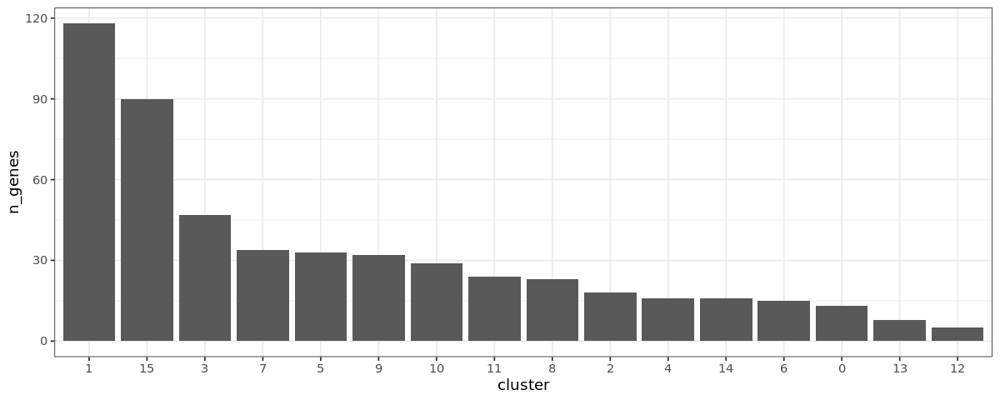

In [7]:
options(repr.plot.width = 10, repr.plot.height = 4)
df0$cluster = as.factor(df0$cluster)
df0 %>%
  mutate(cluster = fct_reorder(cluster, desc(n_genes))) %>%
  ggplot( aes(x=cluster, y=n_genes)) +
    geom_bar(stat="identity") +
    xlab("cluster") +
    theme_bw()

In [8]:
df = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_endodiff/new/effect_sizes_clustering/scaled_absolute_old_eff_sizes_10pcs_as_spatial_downsample_10pct.csv", row.names = 1)
df_pcs = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_endodiff/new/effect_sizes_clustering/scaled_absolute_old_eff_sizes_10pcs_as_spatial_downsample_10pct_pcs.csv", row.names = 1)
df_umaps = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_endodiff/new/effect_sizes_clustering/scaled_absolute_old_eff_sizes_10pcs_as_spatial_downsample_10pct_umaps.csv", row.names = 1)

In [9]:
head(df)

,ENSG00000001460_STPG1.1_24754406_T_A,ENSG00000005059_CCDC109B.4_110648632_T_A,ENSG00000006016_CRLF1.19_18669987_G_A,ENSG00000006016_CRLF1.19_18735221_G_T,ENSG00000006459_KDM7A.7_139913409_G_A,ENSG00000008311_AASS.7_121856717_A_G,ENSG00000008324_SS18L2.3_42588598_G_C,ENSG00000013374_NUB1.7_151058623_A_T,ENSG00000021300_PLEKHB1.11_73339784_G_A,ENSG00000021300_PLEKHB1.11_73364750_G_A,...,ENSG00000253203_GUSBP3.5_68922087_T_G,ENSG00000254087_LYN.8_57005784_T_C,ENSG00000254184_TYW1B.7_72200923_G_A,ENSG00000254184_TYW1B.7_72255343_C_A,ENSG00000254772_EEF1G.11_62315699_G_A,ENSG00000254772_EEF1G.11_62418921_T_A,ENSG00000256018_HIST1H3G.6_26198845_G_C,ENSG00000259024_TVP23C.CDRT4.17_15434991_C_T,ENSG00000267323_SLC25A1P5.19_28298186_T_C,ENSG00000267323_SLC25A1P5.19_28365747_C_T
21241_6#105,0.1281024,0.15549753,0.3564170,0.01439281,0.4351054,0.3650886,0.06399535,0.5056275,0.16749441,0.15734732,...,0.19741989,0.02955871,0.3845423,0.4565280,0.4846137,0.4143908,0.004153441,0.3297417,0.41767324,0.40946395
21241_6#109,0.2044443,0.03385149,0.3814746,0.04295316,0.4729133,0.3208838,0.10370622,0.6279580,0.20525177,0.19499318,...,0.19010699,0.08984909,0.4728067,0.5345127,0.4141319,0.4128888,0.004543933,0.4823078,0.42106806,0.41153756
21241_6#128,0.2812660,0.08262439,0.3849066,0.11059930,0.2184743,0.3481246,0.13066211,0.5597765,0.40985951,0.39531742,...,0.08771053,0.05704777,0.6708870,0.6933525,0.2290543,0.3340659,0.065049971,0.1604316,0.57714740,0.56322715
21241_6#13,0.3733741,0.27656749,0.4858291,0.07771185,0.6764658,0.1668735,0.10568418,0.7632175,0.19413171,0.19550398,...,0.32177816,0.00981691,0.3795532,0.4792380,0.4394067,0.4608017,0.018528006,0.6857668,0.16735636,0.15018582
21241_6#147,0.3854993,0.24667220,0.4962357,0.10713688,0.7052619,0.1816951,0.15126461,0.7860520,0.06496497,0.07421440,...,0.30994647,0.15162873,0.4766594,0.5595455,0.4545136,0.3680533,0.034573704,0.5719024,0.36050986,0.35003001
21241_6#152,0.3415968,0.38265334,0.5144751,0.13113015,0.6347140,0.3481193,0.07805273,0.5884038,0.06529612,0.06471147,...,0.25801890,0.17763445,0.3306258,0.4019217,0.3926247,0.5411949,0.113166756,0.5239429,0.08369751,0.07016615


In [10]:
colnames(df) = gsub("\\.","-",colnames(df))

In [11]:
head(df_umaps)

,UMAP1,UMAP2
21241_6#105,1.4867533,-4.363496
21241_6#109,1.5948211,-4.383133
21241_6#128,-0.2663969,-5.379307
21241_6#13,5.5661277,-5.825747
21241_6#147,5.3375972,-5.657656
21241_6#152,5.6510270,-5.835555


In [12]:
cluster = "1"
# df_clusters[df_clusters$label == cluster,]
genes = df_clusters[df_clusters$label == cluster,"gene"]

In [13]:
options(repr.plot.width = 5, repr.plot.height = 3)

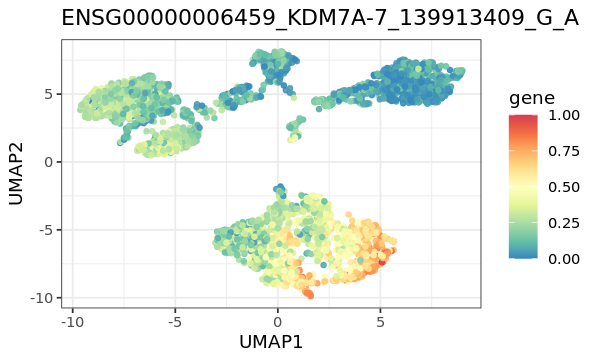

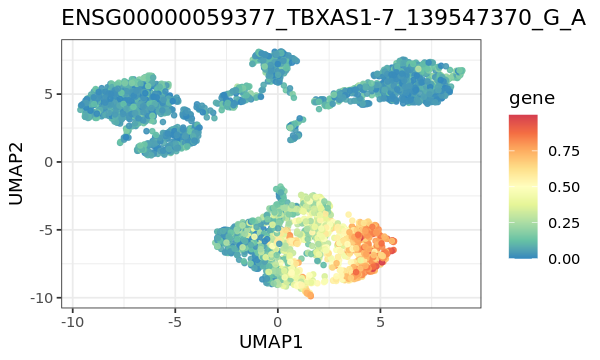

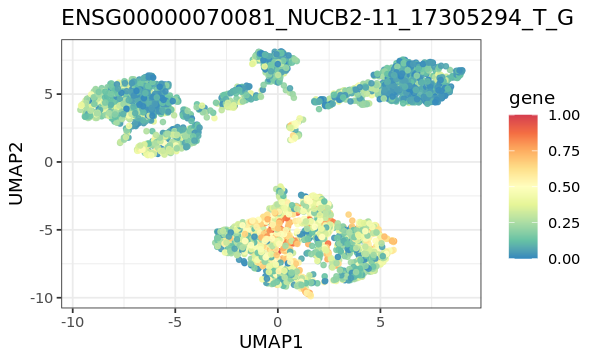

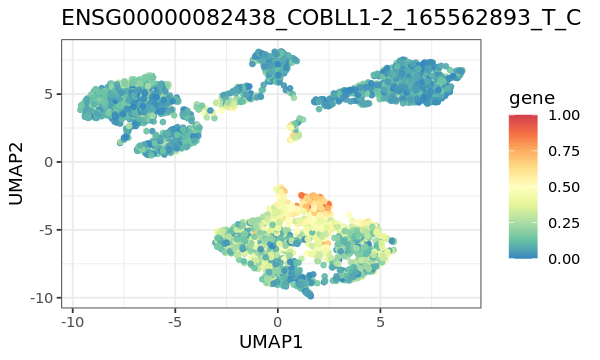

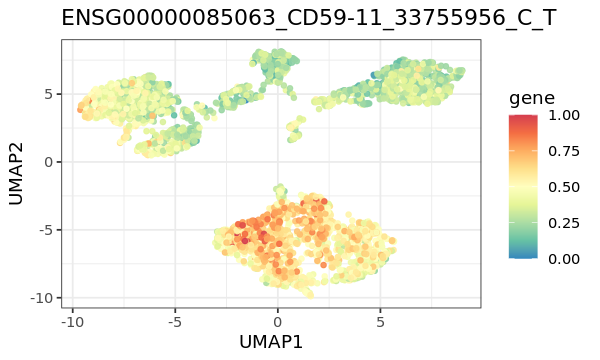

...

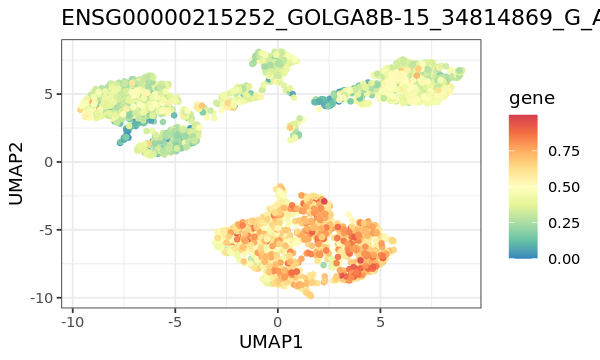

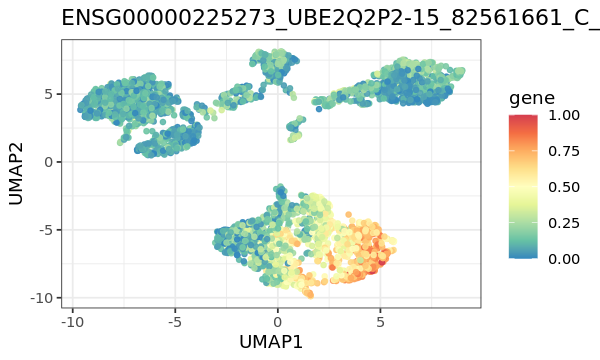

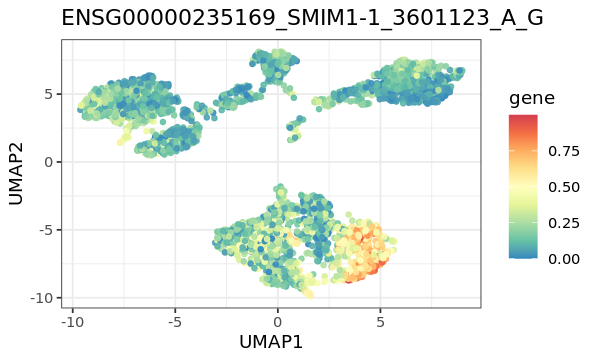

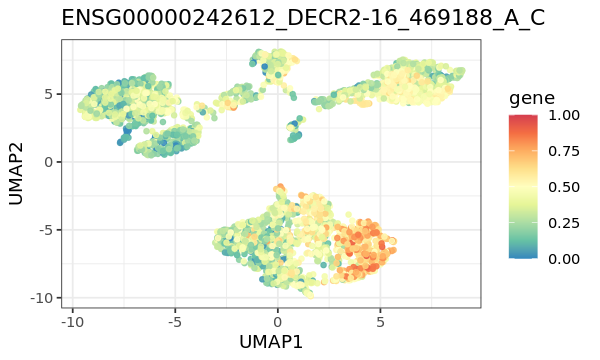

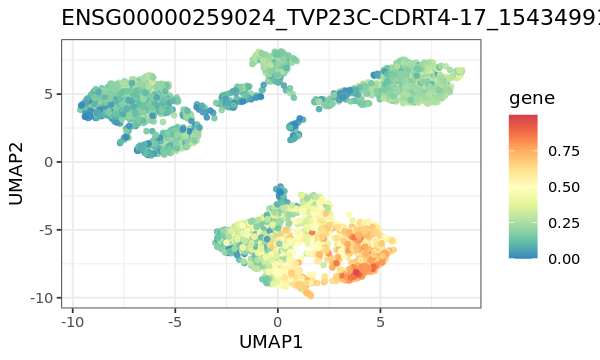

In [14]:
for (gene in genes){
#     print(gene)
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
#     print(head(df_to_plot))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

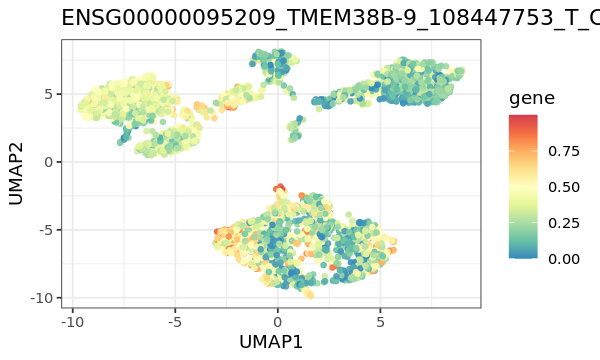

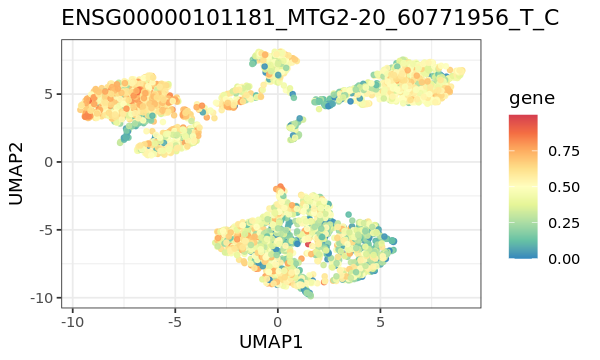

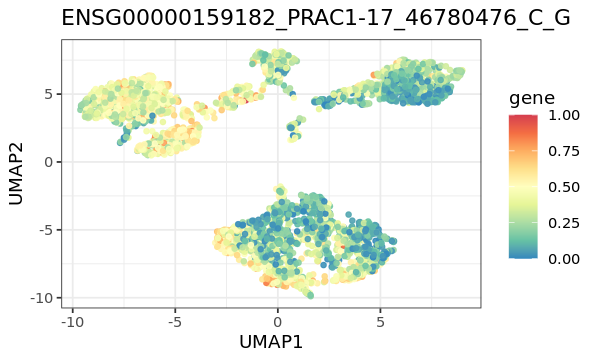

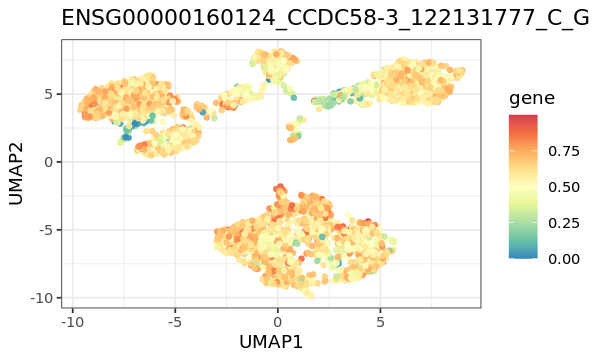

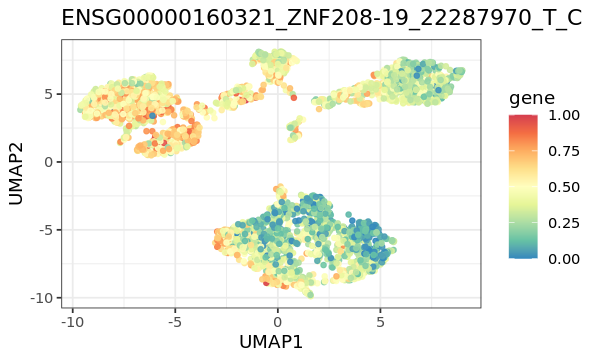

...

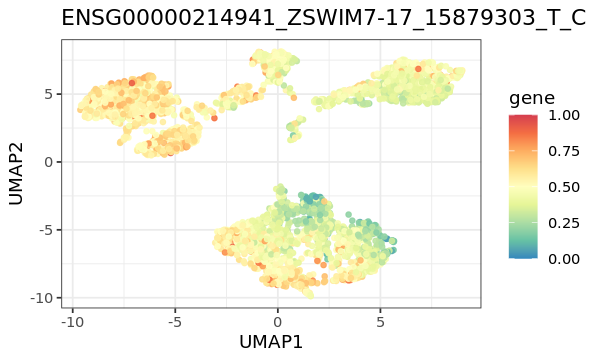

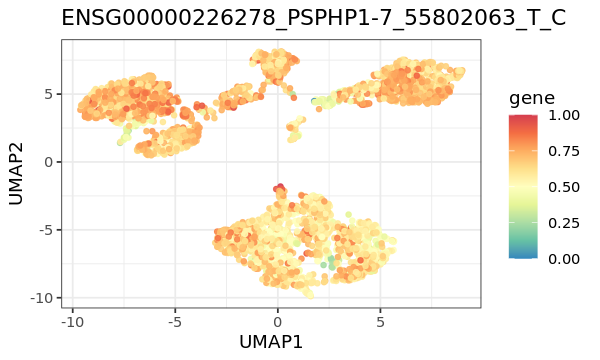

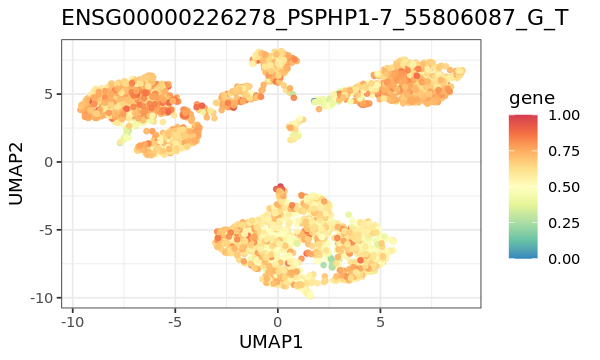

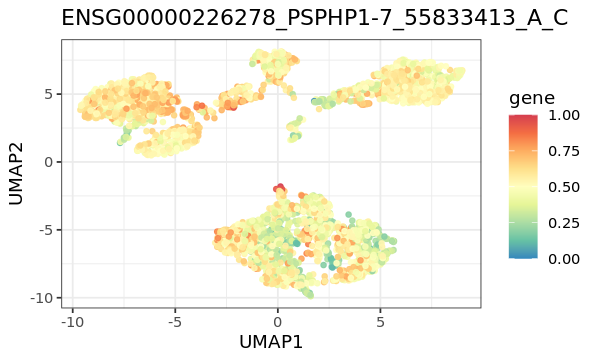

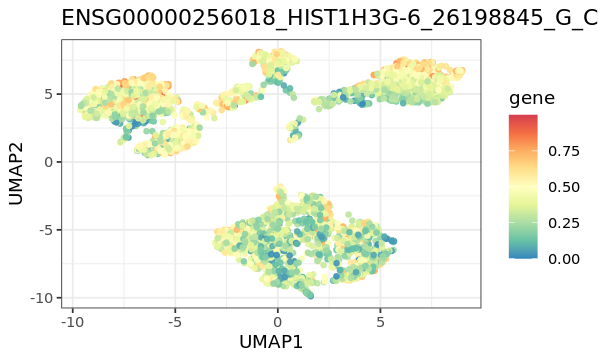

In [21]:
cluster = "6"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

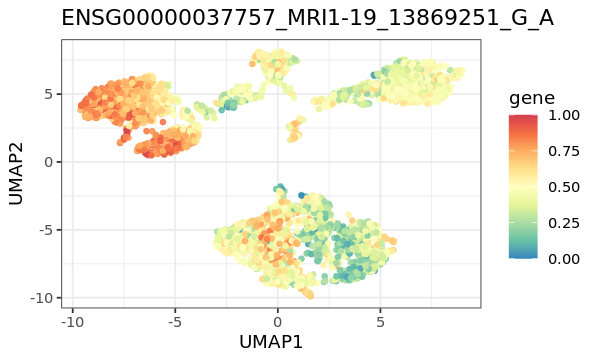

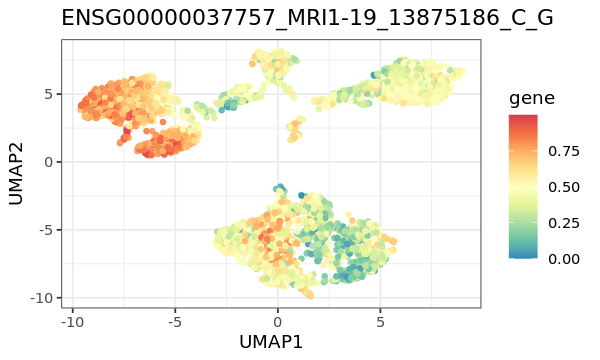

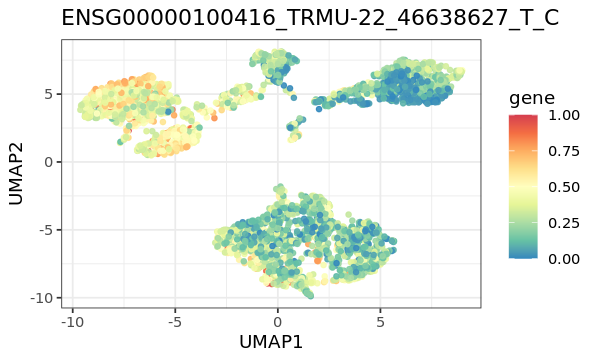

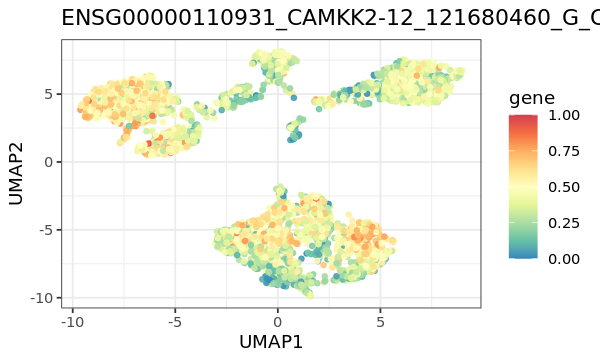

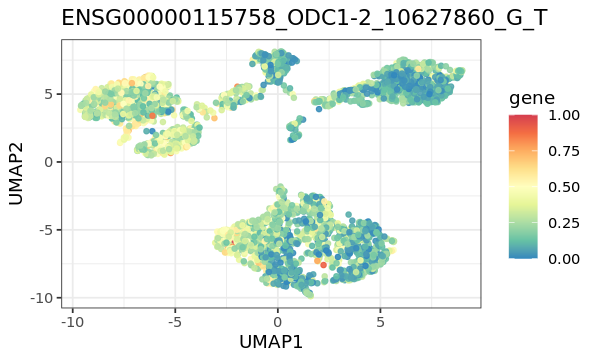

...

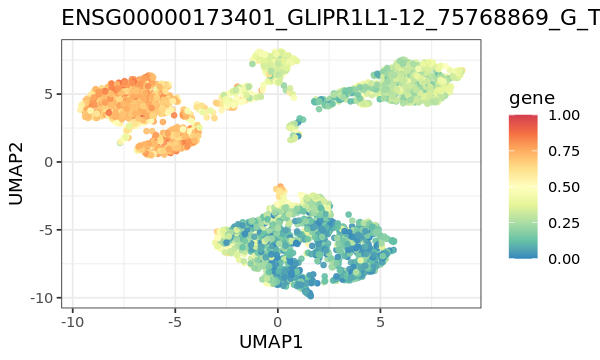

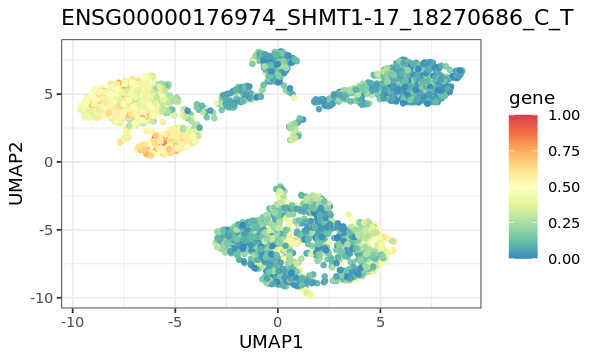

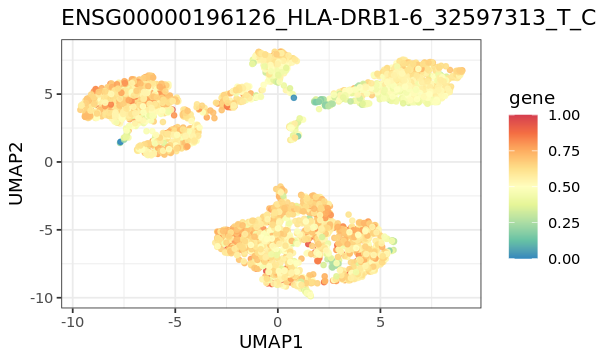

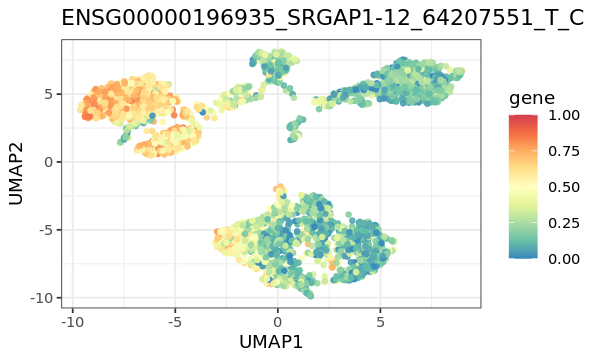

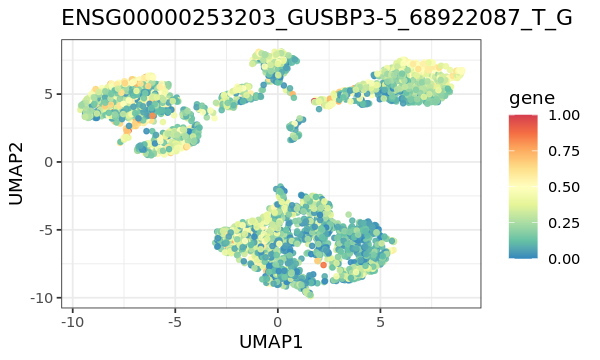

In [22]:
cluster = "8"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

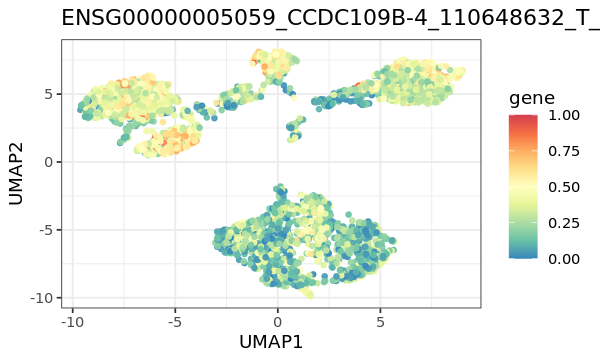

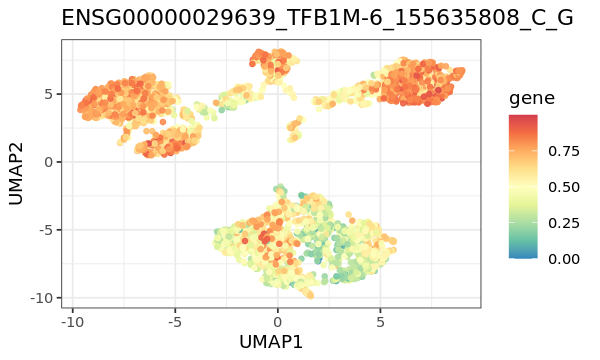

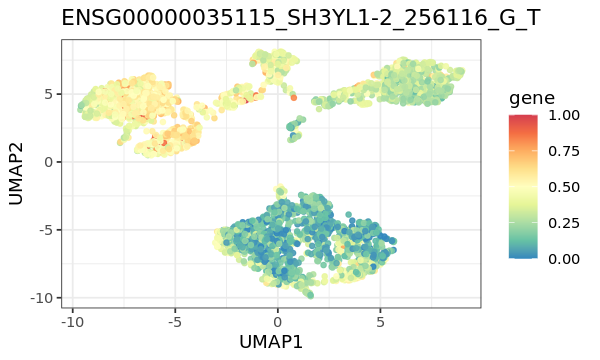

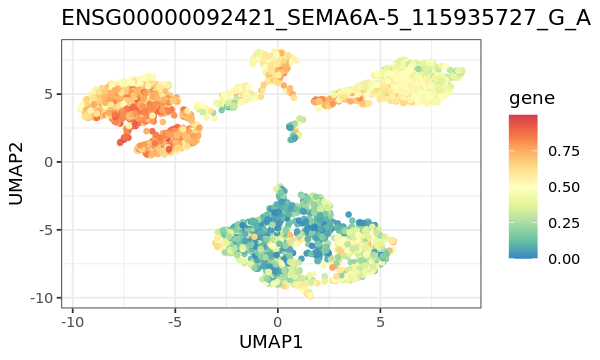

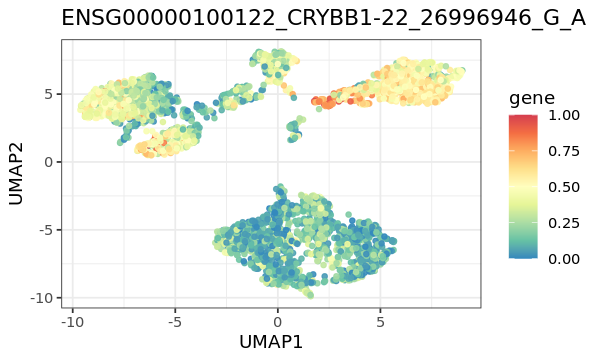

...

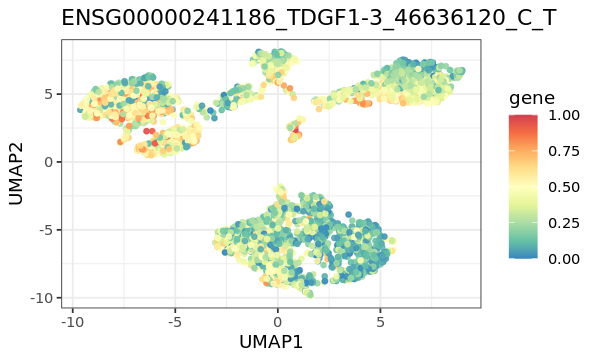

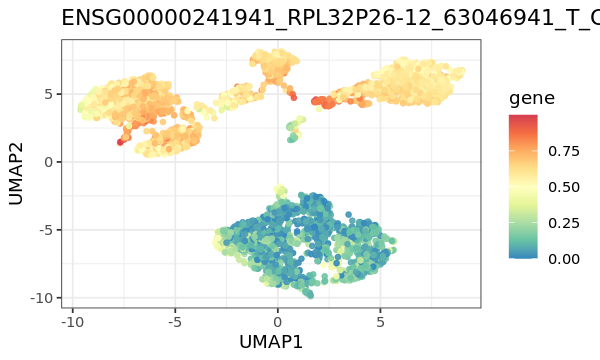

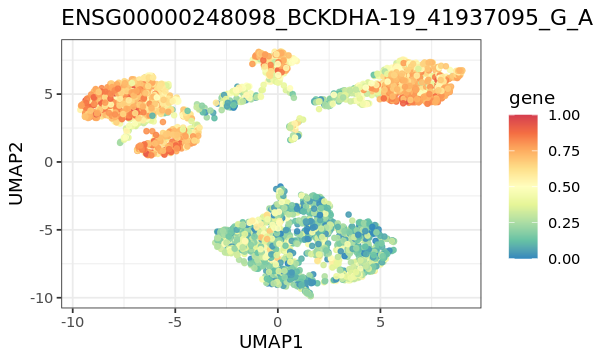

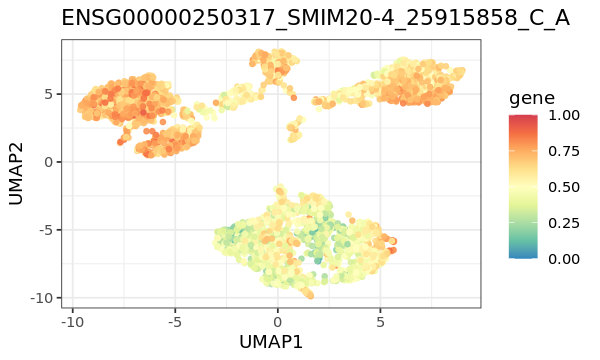

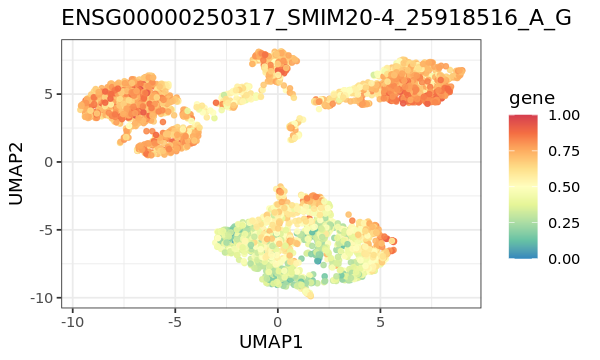

In [23]:
cluster = "7"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

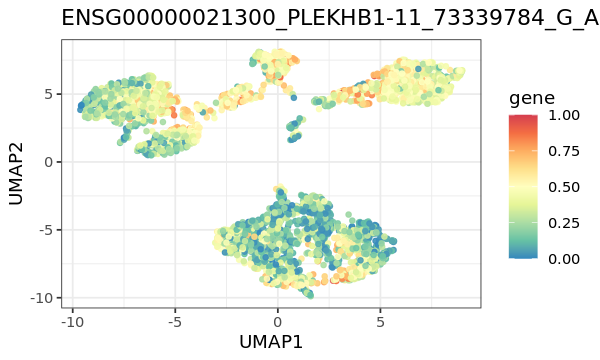

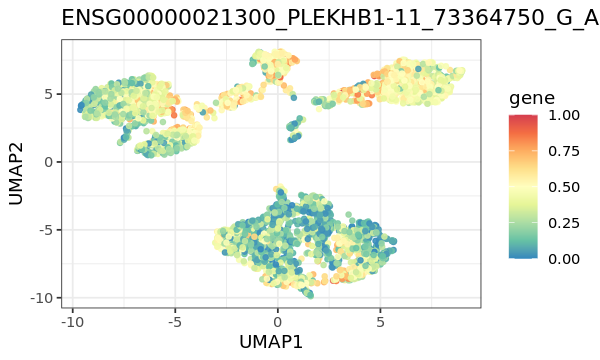

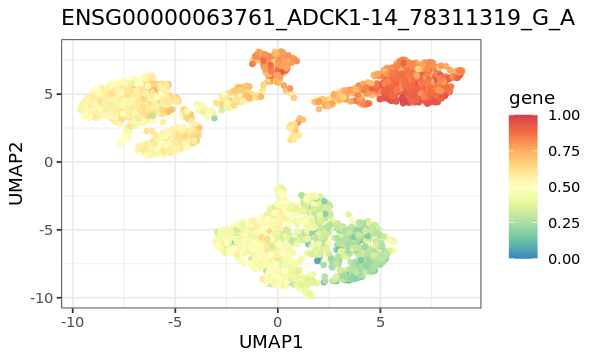

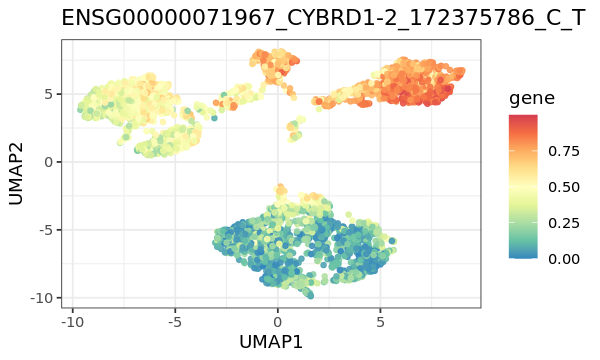

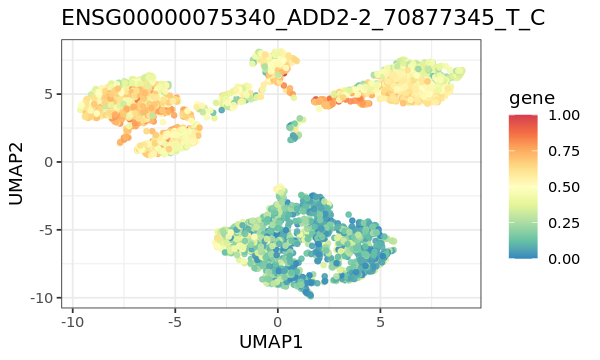

...

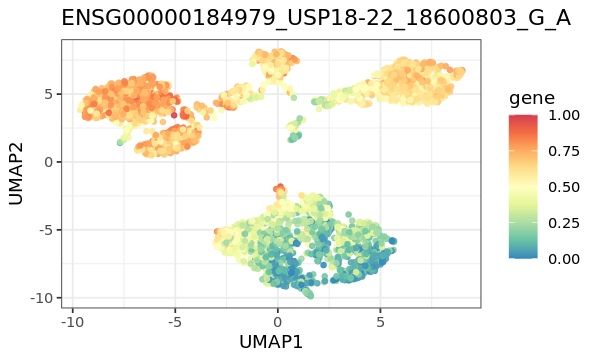

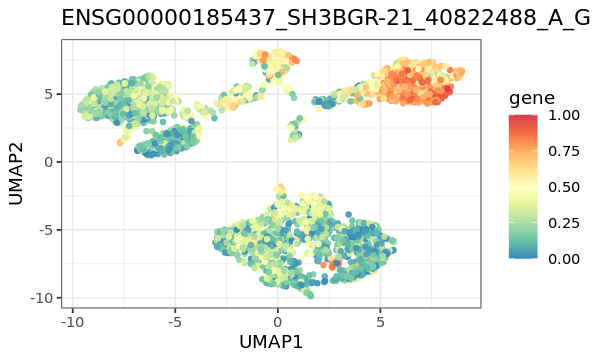

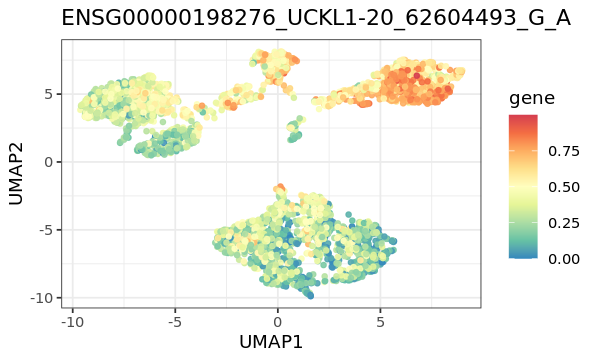

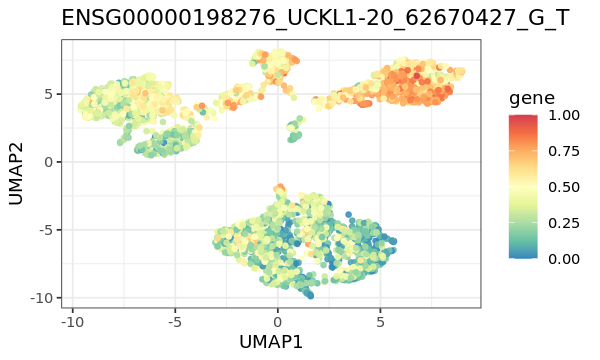

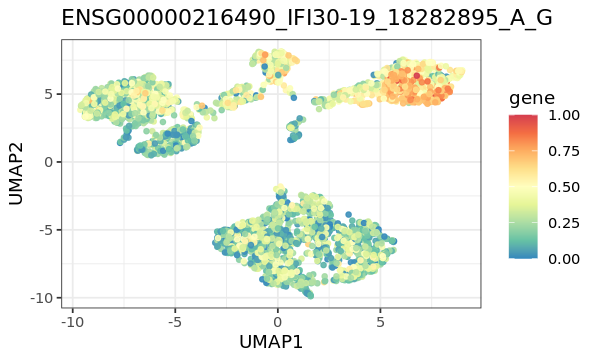

In [24]:
cluster = "3"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

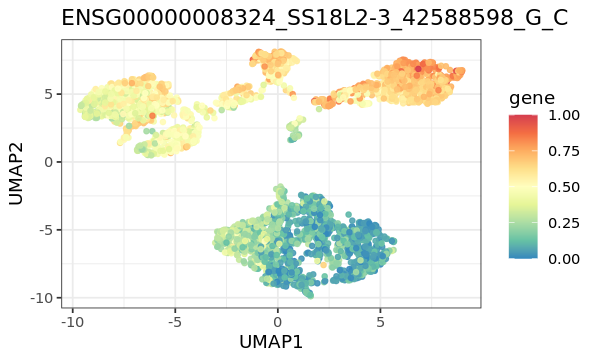

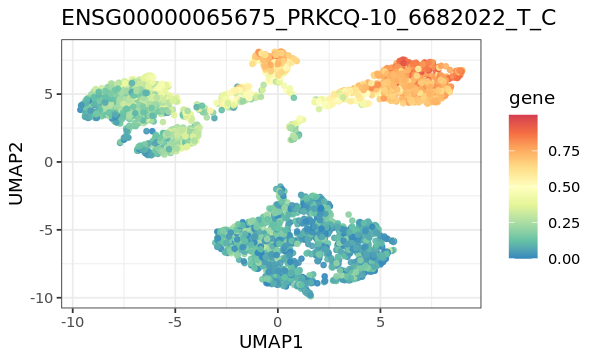

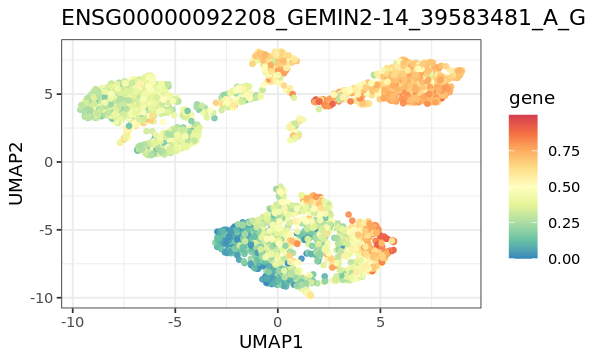

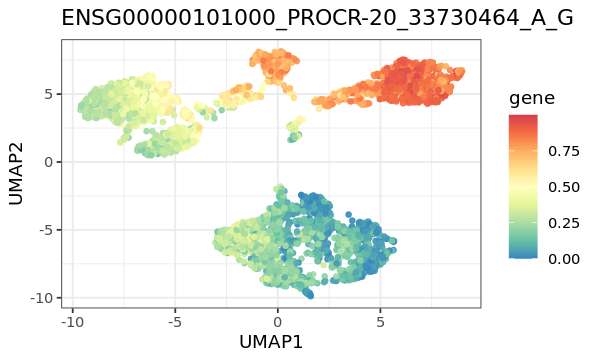

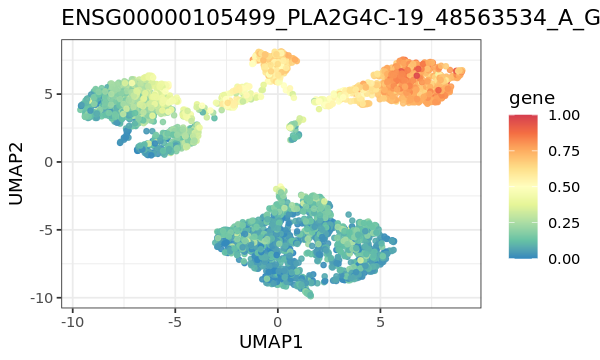

...

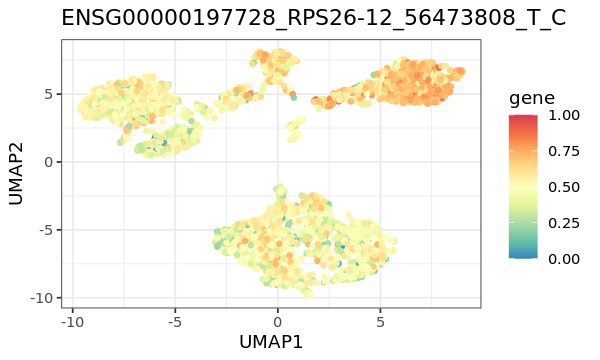

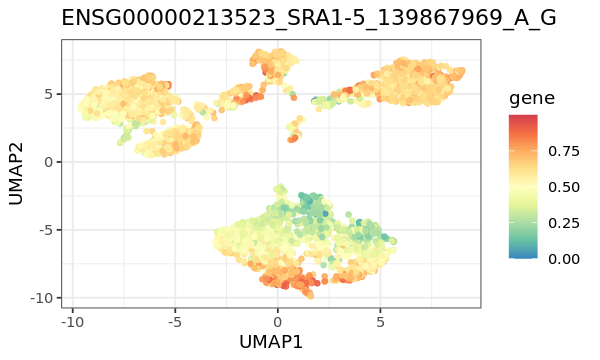

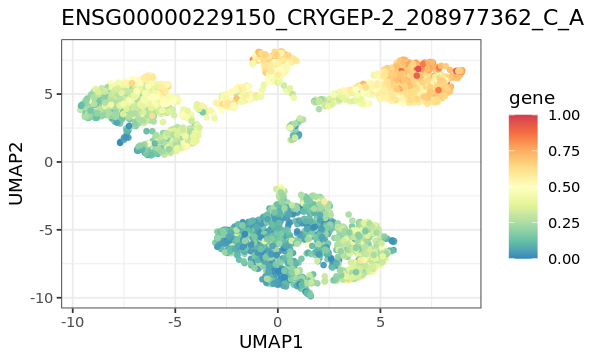

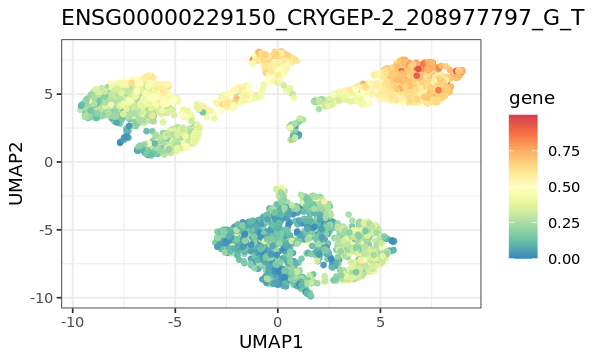

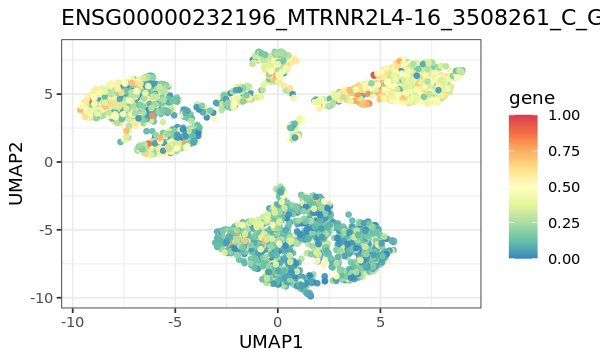

In [19]:
cluster = "9"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

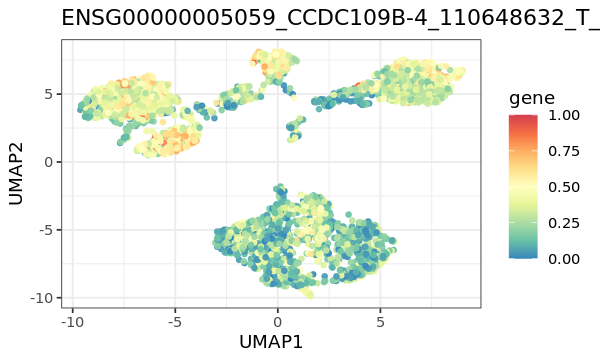

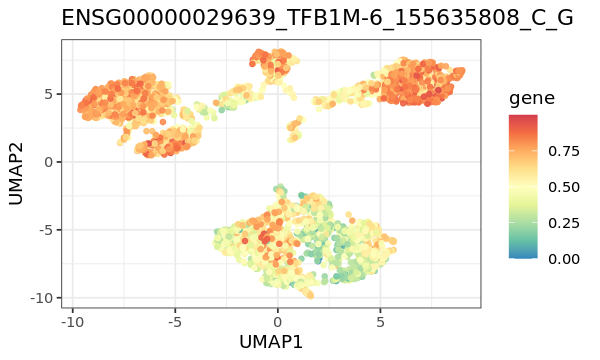

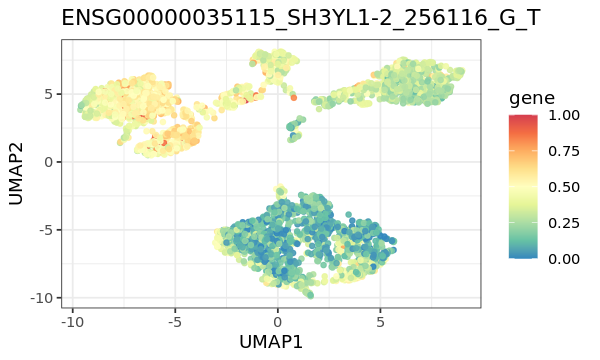

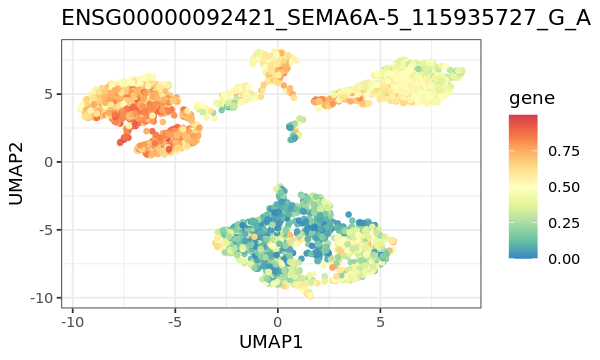

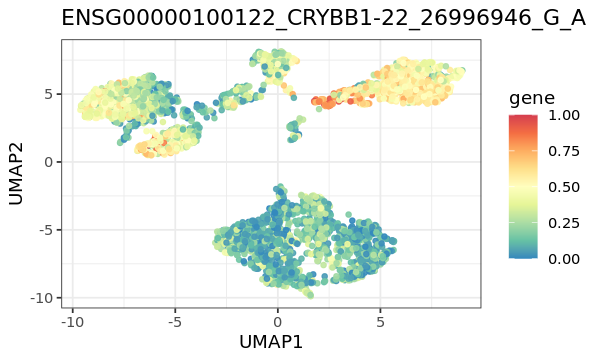

...

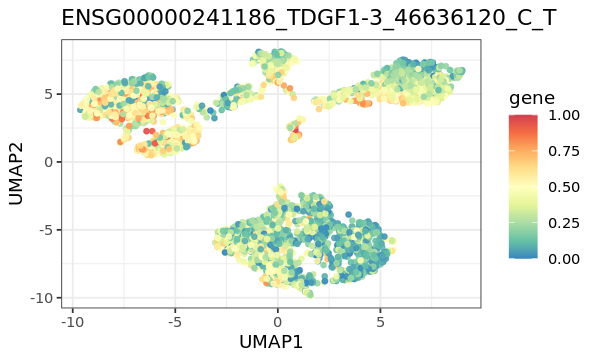

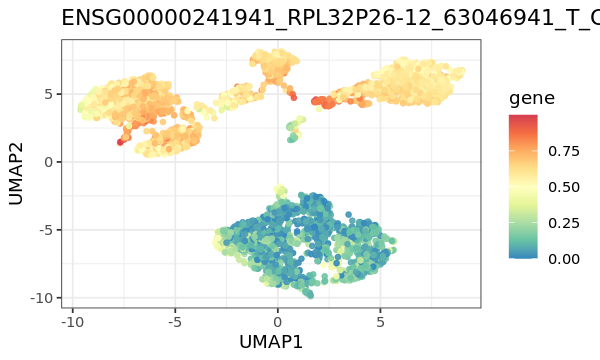

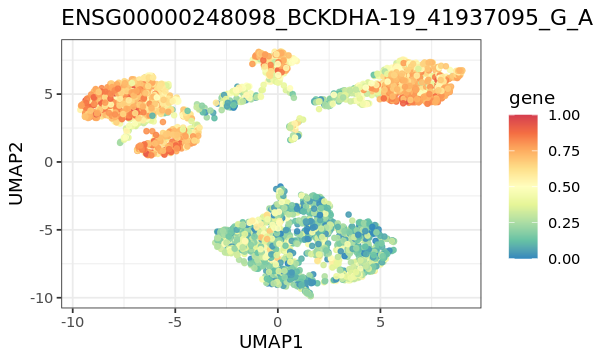

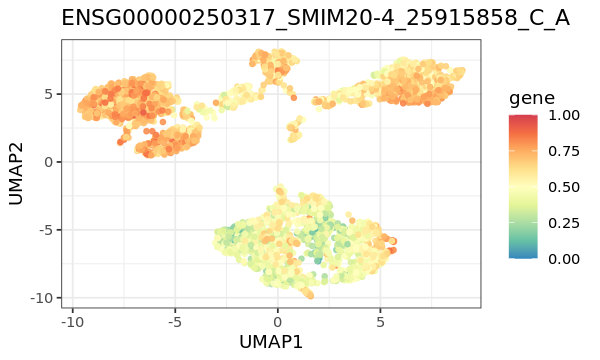

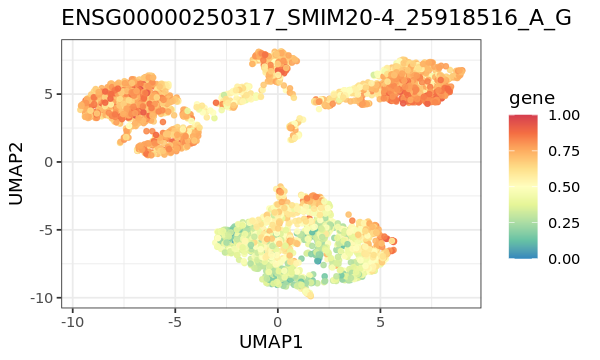

In [25]:
cluster = "7"
genes = df_clusters[df_clusters$label == cluster,"gene"]
for (gene in genes){
    df_to_plot = cbind(df_umaps[,c("UMAP1","UMAP2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = UMAP1, y = UMAP2, col = gene)) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}